In [1]:
# https://www.kaggle.com/competitions/kuzushiji-recognition/data
import numpy as np
import os 
import cv2 

In [2]:
# Defining CONST
DIR = "/home/harris/Projects/ML/Datasets/Kuzushiji-Recognition/"

In [9]:
import pandas as pd

'''CLEANING DATA'''

# Read in the unicode translation
unicode_map = {codepoint: char for codepoint, char in pd.read_csv(DIR + '/unicode_translation.csv').values}
integer_map = {codepoint: i for i, codepoint in enumerate(unicode_map.keys())}

# Read in the training data
data = pd.read_csv(DIR + '/train.csv')

# Check for null values
print(data.isnull().sum())

# Check for duplicates
print(data.duplicated().sum())

# Remove characters that don't have a unicode translation
def filter_labels(row, valid_keys):
    elements = row['labels'].split(' ')
    split_elements = [elements[i:i+5] for i in range(0, len(elements), 5)]
    filtered_elements = []

    for element in split_elements:
        if element[0] in valid_keys:
            filtered_elements.append(element)
        else:
            filtered_elements.append(['e'] + element[1:])

    return " ".join(np.asarray(filtered_elements).flatten())

data['labels'] = data.apply(lambda row: filter_labels(row, unicode_map.keys()), axis=1)

# Add error-encoding to maps
unicode_map['e'] = 'e'
integer_map['e'] = len(integer_map)

# Get character count per manuscript
data['n_char'] = data['labels'].apply(lambda x: len(x.split(' ')) // 5)

# Display sample data
data.head()

image_id    0
labels      0
dtype: int64
0


,image_id,labels,n_char
0,100241706_00004_2,U+306F 1231 3465 133 53 U+304C 275 1652 84 69 ...,67
1,100241706_00005_1,U+306F 1087 2018 103 65 U+304B 1456 1832 40 73...,80
2,100241706_00005_2,U+306F 572 1376 125 57 U+306E 1551 2080 69 68 ...,78
3,100241706_00006_1,U+3082 1455 3009 65 44 U+516B 1654 1528 141 75...,72
4,100241706_00007_2,U+309D 1201 2949 27 33 U+309D 1196 1539 27 36 ...,167


/tmp/ipykernel_5609/4146957043.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation=90)


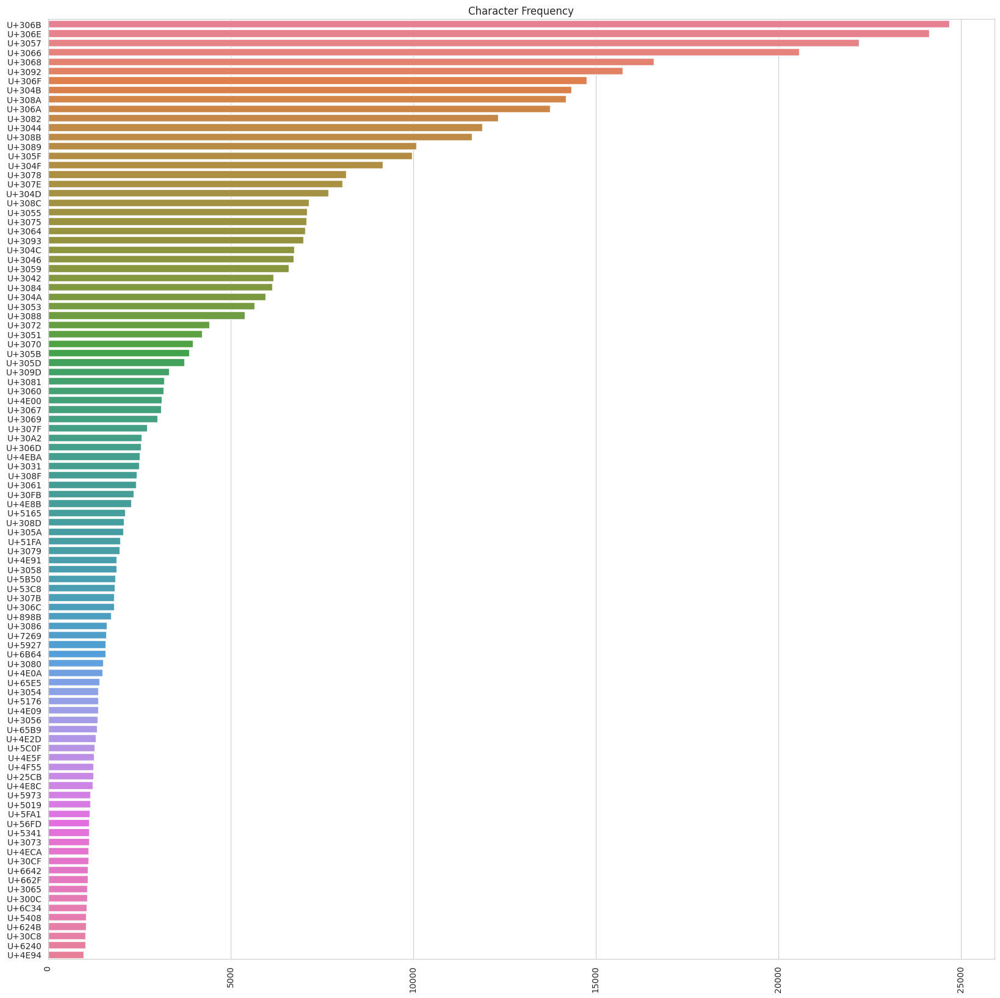

In [23]:
# Analyze character frequency
chars = [c for c in data['labels'].str.split(' ', expand=True).stack()]
chars = [chars[c] for c in range(0, len(chars), 5)]

# Create dictionary with each char and its frequency
char_freq = {}
for char in chars:
    if char in char_freq:
        char_freq[char] += 1
    else:
        char_freq[char] = 1

# Sort dictionary by frequency
char_freq = sorted(char_freq.items(), key=lambda x: x[1], reverse=True)

# Display heatmap of character frequency for first 50 characters
import matplotlib.pyplot as plt
import seaborn as sns

sns.set_style('whitegrid')
fig, ax = plt.subplots(figsize=(20, 20))
sns.barplot(x=[c[1] for c in char_freq[:100]], y=[c[0] for c in char_freq[:100]], ax=ax, hue=[c[0] for c in char_freq[:100]])
ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
ax.set_title('Character Frequency')
plt.show()

In [29]:
from tqdm import tqdm
import random as rand
import matplotlib as mpl
from PIL import Image
import shutil
import gc

def extract_data(img_encoding, img_size):
   '''
   Takes in an image_file & its char encoding, returning all the characters & labels for that image 
   '''

   # Clean data to be individal images
   seg_encoding = img_encoding[1].split(" ")
   seg_encoding = [seg_encoding[i:i+5] for i in range(0, len(seg_encoding), 5)]
   
   # Shuffle encoding to ignore ordering
   rand.shuffle(seg_encoding)

   # Read in the image and convert to threshold
   img = Image.open(DIR + "/train_images/" + img_encoding[0] + ".jpg").convert("RGBA")
   info = []

   # Loop through each character and get encoding
   for idx, (codepoint, x, y, w, h) in enumerate(seg_encoding):         
      try: 
         # Clean image
         x,y,w,h = int(x), int(y), int(w), int(h)
         codepoint = unicode_map[codepoint]         
         cropped_img = img.crop((x, y, x+w, y+h))
         resized_img = cropped_img.resize((img_size, img_size))
         resized_img = np.array(resized_img)
         ret, im_th = cv2.threshold(cv2.cvtColor(resized_img, cv2.COLOR_BGR2GRAY), 130, 255, cv2.THRESH_BINARY_INV)
         
         # Save image
         result = Image.fromarray(im_th)
         file_name = img_encoding[0] + '_{}.jpg'.format(idx)
         result.save(DIR + "/cleaned_images/" + file_name)

         info.append((file_name, codepoint))

      except Exception as E:
         print(f"There was an exception with: {E}")
   
   del seg_encoding, img, result, im_th, resized_img, cropped_img
   gc.collect()

   return info

def extract_all_data(img_size):
   '''
   Takes in the image size and returns all the images & labels for the training set
   '''

   # Get all the images
   images = data[['image_id', 'labels', 'n_char']].values
   generated = 0
   info = [] 

   for i in tqdm(range(len(images))):

      # Extract the data
      info += extract_data(images[i], img_size)
      generated += images[i][2]
   
      if (i+1) % 500 == 0 or i == len(images)-1:
         shutil.make_archive('knist_' + str(i//500), 'zip', DIR + "/cleaned_images/")
         print(f"Generated {i+1} batch images")
         shutil.rmtree(DIR + "/cleaned_images/")
         os.mkdir(DIR + "/cleaned_images/")

   return info

info = extract_all_data(64)
print(info)

# def display_sample(X, Y,  num_samples=20):
#    '''
#    Takes a random subsample of characters and displays them
#    '''

#    if num_samples > 200:
#       print("Please enter a number less than 200")
#       return
   
#    indicies = rand.sample(range(0, len(X)), num_samples)
#    X_samples = [X[i] for i in indicies]   
#    Y_samples = [Y[i] for i in indicies]

#    # Change font to allow Japaense characters
#    plt.figure(figsize=(20,20))
#    mpl.rcParams['font.family'] = 'Noto Sans CJK JP'

#    for i, sample in enumerate(range(num_samples)):
#       plt.subplot(4, 5, i+1)
#       plt.title(Y_samples[i])
#       plt.imshow(X_samples[i])


# X_train, Y_train = extract_data()
# display_sample(X_train, Y_train)
# print(len(X_train))


  0%|          | 0/3605 [00:00<?, ?it/s]

 14%|█▍        | 499/3605 [01:36<10:28,  4.94it/s]

Generated 500 batch images


 28%|██▊       | 999/3605 [03:38<08:44,  4.97it/s]  

Generated 1000 batch images


 42%|████▏     | 1499/3605 [05:47<07:42,  4.55it/s]  

Generated 1500 batch images


 55%|█████▌    | 1999/3605 [07:55<05:54,  4.53it/s]  

Generated 2000 batch images


 69%|██████▉   | 2499/3605 [10:05<05:17,  3.48it/s]  

Generated 2500 batch images


 83%|████████▎ | 2999/3605 [12:10<02:04,  4.86it/s]  

Generated 3000 batch images


 97%|█████████▋| 3499/3605 [14:10<00:18,  5.61it/s]

Generated 3500 batch images


100%|█████████▉| 3604/3605 [14:44<00:00,  4.62it/s]

Generated 3605 batch images


100%|██████████| 3605/3605 [14:47<00:00,  4.06it/s]

[('100241706_00004_2_0.jpg', 'の'), ('100241706_00004_2_1.jpg', 'や'), ('100241706_00004_2_2.jpg', '子'), ('100241706_00004_2_3.jpg', 'こ'), ('100241706_00004_2_4.jpg', 'が'), ('100241706_00004_2_5.jpg', 'し'), ('100241706_00004_2_6.jpg', '己'), ('100241706_00004_2_7.jpg', '細'), ('100241706_00004_2_8.jpg', 'を'), ('100241706_00004_2_9.jpg', '若'), ('100241706_00004_2_10.jpg', 'か'), ('100241706_00004_2_11.jpg', 'け'), ('100241706_00004_2_12.jpg', '人'), ('100241706_00004_2_13.jpg', '畳'), ('100241706_00004_2_14.jpg', 'そ'), ('100241706_00004_2_15.jpg', '俳'), ('100241706_00004_2_16.jpg', 'し'), ('100241706_00004_2_17.jpg', '避'), ('100241706_00004_2_18.jpg', '浮'), ('100241706_00004_2_19.jpg', 'た'), ('100241706_00004_2_20.jpg', 'の'), ('100241706_00004_2_21.jpg', 'だ'), ('100241706_00004_2_22.jpg', '及'), ('100241706_00004_2_23.jpg', '世'), ('100241706_00004_2_24.jpg', '根'), ('100241706_00004_2_25.jpg', '序'), ('100241706_00004_2_26.jpg', '息'), ('100241706_00004_2_27.jpg', '気'), ('100241706_00004_2_28.jpg', 

In [190]:
import random

def data_generator(data, batch_size, total_batches, img_size):
   '''Creates a generator that returns a batch of data'''
   
   # Create random indicies for image_data
   indicies = rand.sample(range(0, len(data)), len(data))
   
   X_batch, Y_batch = [], []
   
   # Assert that the number of batches is correct
   # assert sum([len(data.iloc[i]['labels']) // 5 for i in data]) // batch_size + 1 == total_batches

   while True:
      mnspt_idx = 0

      # Create batch
      for batch_num in range(total_batches):
         
         while(mnspt_idx < len(data) and len(X_batch) < batch_size):   
            # Extract next manuscript
            X_temp, Y_temp = extract_data(data.values[indicies[mnspt_idx]], img_size)
            
            # print(f'X_temp type: {type(X_temp)} at {data.values[indicies[mnspt_idx]]}')

            if(len(X_batch) == 0):
               X_batch = X_temp
               Y_batch = Y_temp
            
            else:
               X_batch = np.concatenate((X_batch, X_temp), axis=0)
               Y_batch = np.concatenate((Y_batch, Y_temp), axis=0)
               
            # Increment manuscript
            mnspt_idx = mnspt_idx + 1
            # print(f'MNSPT_IDX: {mnspt_idx}')
                  
         # Seperate batch & remaining characters 
         X_temp = X_temp[batch_size:]
         Y_temp = Y_temp[batch_size:]
         
         X_result = X_batch[:batch_size]
         Y_result = Y_batch[:batch_size]
      
         X_batch = X_temp
         Y_batch = Y_temp

         # print("X_batch dtype: ", X_batch.dtype, " Y_batch dtype: ", Y_batch.dtype)

         yield X_result, Y_result

         if mnspt_idx >= len(data):
            mnspt_idx = 0
            print("Resetting mnspt_idx")
            rand.shuffle(indicies)

# mmdetection/mmdet/datasets/pipelines/test_aug.py

In [140]:
   # def collect_training(dataPath, trainImagePath):
   #    imageNames = os.listdir(os.path.join(DIR + trainImagePath))
   #    df = pd.read_csv(os.path.join(DIR + dataPath))
      
   #    # Check if there is a directory called \"training_images\" if there is, empty it otherwise make one,
   #    training_dir = os.path.join(DIR + "/segmented_training_images")
   #    if os.path.exists(training_dir):
   #       for filename in os.listdir(training_dir):
   #          file_path = os.path.join(training_dir, filename)
   #          try:
   #             os.remove(file_path)
   #          except Exception as e:
   #             print('Failed to delete %s. Reason: %s' % (file_path, e))
   #          else:
   #             os.makedirs(training_dir)

   #          print(imageNames)      print(E)

   #             rects = [chars[i:i+5] for i in range(0, len(chars), 5)]

   #             for i, rect in enumerate(rects):
   #                # Save a file for each character
   #                char, x, y, w, h = rect
   #                char_img = img[int(y):int(y)+int(h), int(x):int(x)+int(w)]
   #                cv2.imwrite(os.path.join(training_dir + " ", f"{ID}_{i}_{char}.jpg"), char_img)
                              
   #    # FILEPATH: /home/harris/Projects/AI-Stuff/AI-foundations/Competitions/Kuzushiji-Recognition-Comp/clean-data.ipynb
   #    collect_training("train.csv", "train_images")


In [196]:
from sklearn.model_selection import train_test_split

# Segmenting data to lower training cost
SEGMENT_DATA = len(data)
BATCH_SIZE = 256
IMAGE_SIZE = 128

indicies = rand.sample(range(0, len(data)), SEGMENT_DATA)

# Splitting training, validation and test data
train_indices, test_indices = train_test_split(indicies, test_size=0.2, random_state=42)
train_indices, val_indices = train_test_split(train_indices, test_size=0.2, random_state=42)

# Calculate the number of steps per epoch
train_steps = sum([len(data.iloc[i]['labels'].split(" ")) // 5 for i in train_indices]) // BATCH_SIZE + 1
validation_steps = sum([len(data.iloc[i]['labels'].split(" ")) // 5 for i in val_indices]) // BATCH_SIZE + 1

# Creating generators for training and validation data
training_gen = data_generator(data.iloc[train_indices], BATCH_SIZE, train_steps, IMAGE_SIZE)
validation_gen = data_generator(data.iloc[val_indices], BATCH_SIZE, validation_steps, IMAGE_SIZE)

print(train_steps, validation_steps)
print(len(train_indices), len(val_indices))
print(SEGMENT_DATA)
print(sum([len(data.iloc[i]['labels'].split(" ")) // 5 for i in train_indices]))

1721 424
2307 577
3605
440532


In [197]:
# Creating model
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers

NUM_CLASSES = len(unicode_map.keys())

inputs = keras.Input(shape=(IMAGE_SIZE, IMAGE_SIZE, 1))
x = layers.Conv2D(32, (3,3), padding='same', activation='relu')(inputs)
x = layers.MaxPooling2D((2,2))(x)
x = layers.Conv2D(64, (3,3), padding='same', activation='relu')(x)
x = layers.MaxPooling2D((2,2))(x)
x = layers.GlobalAveragePooling2D()(x)
x = layers.Dense(256, activation='relu')(x)# Calculate the number of steps per epoch

outputs = layers.Dense(NUM_CLASSES, activation='softmax')(x)

model = keras.Model(inputs=inputs, outputs=outputs)

model.summary()

Model: "model_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_10 (InputLayer)       [(None, 128, 128, 1)]     0         
                                                                 
 conv2d_14 (Conv2D)          (None, 128, 128, 32)      320       
                                                                 
 max_pooling2d_14 (MaxPooli  (None, 64, 64, 32)        0         
 ng2D)                                                           
                                                                 
 conv2d_15 (Conv2D)          (None, 64, 64, 64)        18496     
                                                                 
 max_pooling2d_15 (MaxPooli  (None, 32, 32, 64)        0         
 ng2D)                                                           
                                                                 
 global_average_pooling2d_9  (None, 64)                0   

In [187]:
x_batch, y_batch = next(training_gen)
print(x_batch.shape)  # This should show something like (batch_size, height, width, channels)

x_batch, y_batch = next(validation_gen)
print(x_batch.shape)

(1024, 128, 128)
(1024, 128, 128)


In [200]:
#   # Replace with your generator and its parameters
# total_batches = train_steps # Total number of batches
# batch_to_start_inspection = total_batches - 5  # Start inspection 5 batches before the end

# for i in range(total_batches):
#     try:
#         print(f"Batch {i} loaded successfully")
#         X_batch, Y_batch = next(training_gen)
#     except Exception as e:
#         print(f"Error processing batch {i}: {e}")
#         break

In [198]:
# Fit and compile model
model.compile(
    optimizer='rmsprop',
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)

model.fit(
    training_gen,
    steps_per_epoch=train_steps,
    validation_data=validation_gen,
    validation_steps=validation_steps,
    epochs=10
)

Epoch 1/10
1721/1721 [==============================] - 417s 242ms/step - loss: 4.6682 - accuracy: 0.1589 - val_loss: 4.0781 - val_accuracy: 0.2377
Epoch 2/10
1721/1721 [==============================] - 418s 243ms/step - loss: 3.7445 - accuracy: 0.2727 - val_loss: 3.6024 - val_accuracy: 0.3045
Epoch 3/10
1721/1721 [==============================] - 418s 243ms/step - loss: 3.4937 - accuracy: 0.3206 - val_loss: 3.4742 - val_accuracy: 0.3408
Epoch 4/10
1721/1721 [==============================] - 398s 232ms/step - loss: 3.3378 - accuracy: 0.3508 - val_loss: 3.2998 - val_accuracy: 0.3589
Epoch 5/10
1721/1721 [==============================] - 396s 230ms/step - loss: 3.2358 - accuracy: 0.3735 - val_loss: 3.1838 - val_accuracy: 0.3857
Epoch 6/10
1721/1721 [==============================] - 398s 232ms/step - loss: 3.1589 - accuracy: 0.3884 - val_loss: 3.2126 - val_accuracy: 0.3882
Epoch 7/10
1721/1721 [==============================] - 401s 233ms/step - loss: 3.1191 - accuracy: 0.3983 - val_